In [2]:
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import display
import numpy as np
from collections import deque
from imutils.video import VideoStream
import numpy as np
import cv2
import argparse
import time
import imutils

In [3]:
def custom_display(image): 
  image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  display(Image.fromarray(image_rgb))

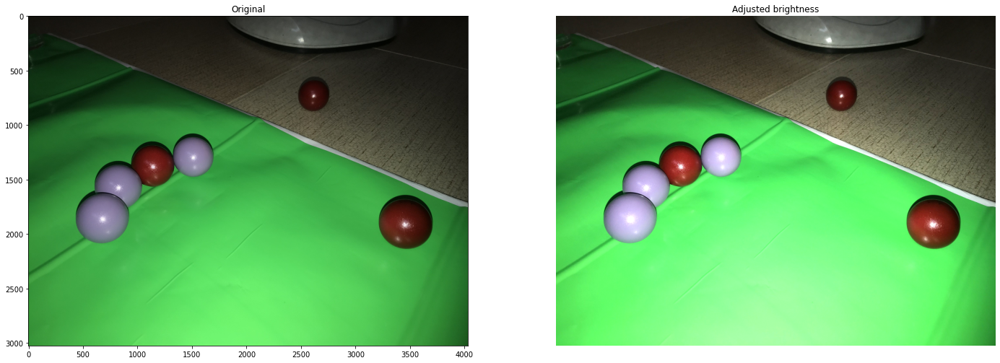

In [4]:
import cv2
import matplotlib.pyplot as plt

# Đọc hình ảnh gốc
frame = cv2.imread("example1.png")

# Tạo một hình với kích thước lớn hơn
plt.figure(figsize=(24, 12))  # Chỉ định kích thước hình (12 inches theo chiều rộng, 6 inches theo chiều cao)

# Hiển thị hình ảnh gốc
plt.subplot(121)
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))  # Chuyển đổi màu từ BGR sang RGB
plt.title('Original')

frame = cv2.imread("example1.png")

# Calculate the brightness of the image
brightness = np.mean(frame)

# Define a brightness threshold and a brightness increase factor
threshold = 100  # Adjust this threshold as needed
brightness_increase = 1.5  # Adjust this factor as needed

# Check if the brightness is below the threshold
if brightness < threshold:
    # Increase the brightness of the entire image
    frame = cv2.convertScaleAbs(frame, alpha=brightness_increase, beta=0)

# Hiển thị hình ảnh sau khi cân bằng sáng
plt.subplot(122)
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
plt.title('Adjusted brightness')

# Tắt trục x và trục y trên các biểu đồ
plt.axis('off')

# Hiển thị hình ảnh trên Jupyter Notebook
plt.show()


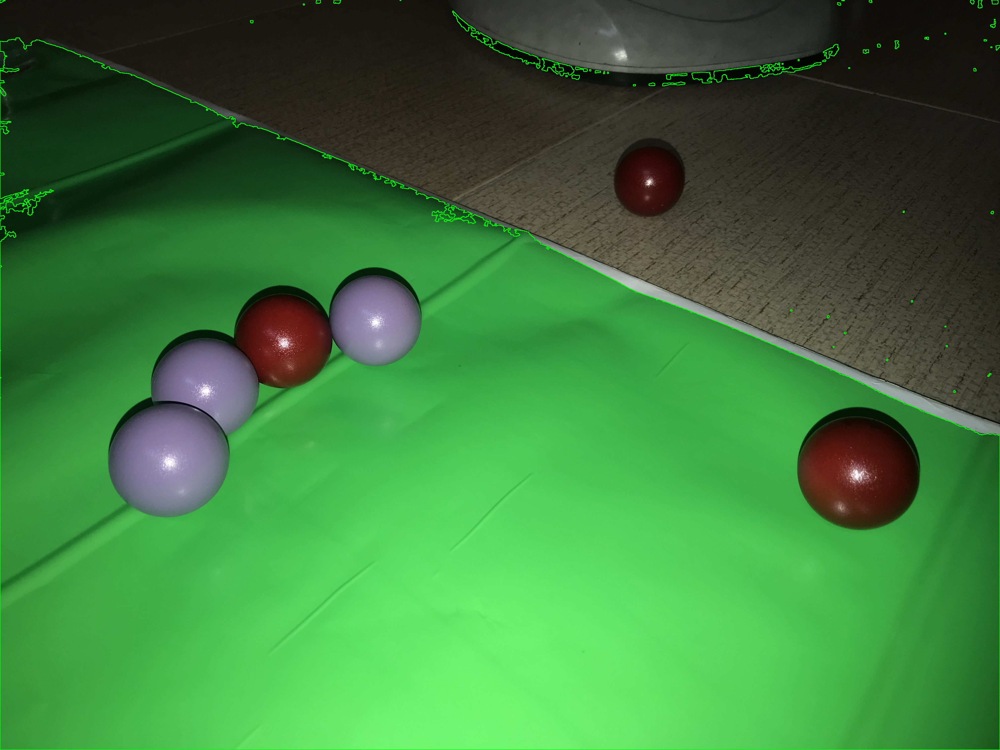

In [5]:
frame = cv2.imread("example1.png")
blurred = cv2.GaussianBlur(frame, (11, 11), 0)
hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
greenLower = (29, 86, 6)
greenUpper = (64, 200, 255)

frame = cv2.imread("example1.png")
blurred = cv2.GaussianBlur(frame, (11, 11), 0)
hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
greenLower = (29, 86, 6)
greenUpper = (64, 200, 255)

mask = cv2.inRange(hsv, greenLower, greenUpper)
mask = cv2.erode(mask, None, iterations=2)
mask = cv2.dilate(mask, None, iterations=2)

# Find contours in the mask
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw the contours on the original frame
cv2.drawContours(frame, contours, -1, (0, 255, 0), 2)
custom_display(frame)


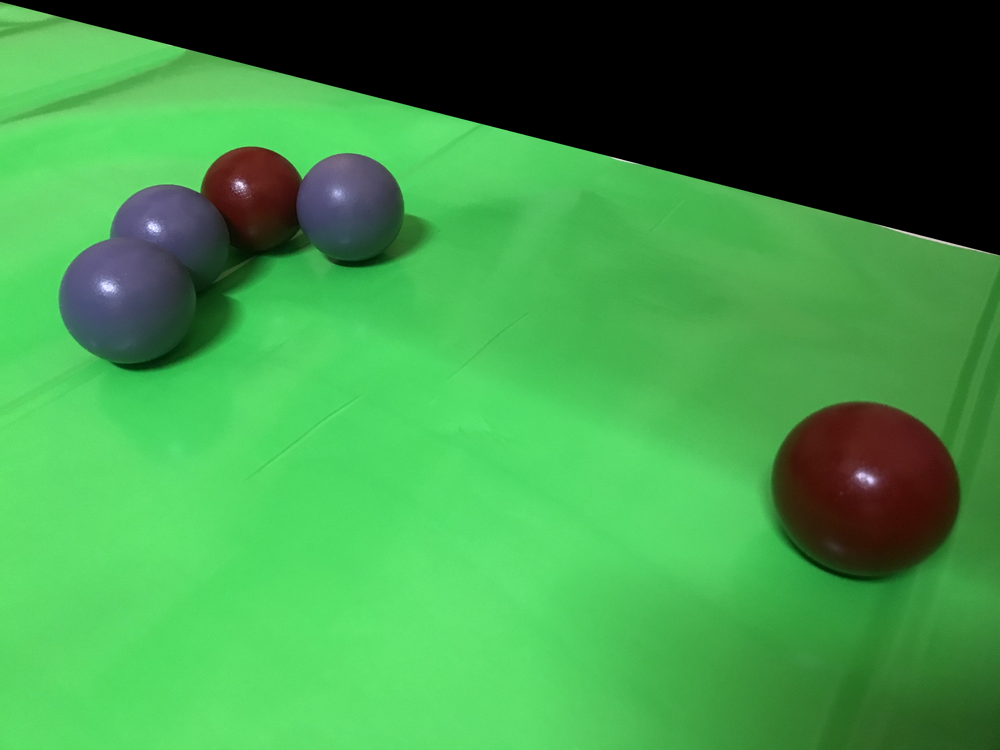

In [17]:
import cv2
import numpy as np

# Đọc hình ảnh gốc
frame = cv2.imread("example2.png")
blurred = cv2.GaussianBlur(frame, (11, 11), 0)
hsv = cv2.cvtColor(blurred, cv2.COLOR_BGR2HSV)
greenLower = (29, 50, 6)
greenUpper = (64, 200, 255)

mask = cv2.inRange(hsv, greenLower, greenUpper)
mask = cv2.erode(mask, None, iterations=2)
mask = cv2.dilate(mask, None, iterations=2)

# Tìm các đường viền trong mask
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Tìm đường viền lớn nhất theo diện tích
largest_contour = max(contours, key=cv2.contourArea)

# Tạo một hình ảnh đen có cùng kích thước với frame
black_image = np.zeros_like(frame)

# Vẽ đường viền lớn nhất trên hình ảnh đen
epsilon = 0.02 * cv2.arcLength(largest_contour, True)
approx = cv2.approxPolyDP(largest_contour, epsilon, True)
cv2.drawContours(black_image, [approx], -1, (255, 255, 255), thickness=cv2.FILLED)

# Sử dụng mask để chỉ hiển thị phần đó trên hình ảnh gốc
frame = cv2.bitwise_and(frame, black_image)

# # replace whree 0 is black and 255 is white
# frame[np.where((frame == [0, 0, 0]).all(axis=2))] = [92, 211, 82] 


# Display the result
custom_display(frame)




In [102]:
define_ball_color = {
    "red": 
        {
            "lower": np.array([0, 115, 0]),
            "upper": np.array([47, 255, 115])
        },
    "blue": 
        {
            "lower": np.array([0, 115, 0]),
            "upper": np.array([47, 255, 115])
        },
    "other": 
        {
            "lower": np.array([90, 12, 60]),
            "upper": np.array([149, 152, 145])  
        }
    }
def rgb_to_hsv_range(rgb_color, tolerance=20):
    # Convert the RGB color to HSV
    hsv_color = cv2.cvtColor(np.uint8([[rgb_color]]), cv2.COLOR_RGB2HSV)[0][0]

    # Create lower and upper HSV values within the tolerance range
    lower_hue = max(0, hsv_color[0] - tolerance)
    upper_hue = min(179, hsv_color[0] + tolerance)
    lower_saturation = max(0, hsv_color[1] - tolerance)
    upper_saturation = min(255, hsv_color[1] + tolerance)
    lower_value = max(0, hsv_color[2] - tolerance)
    upper_value = min(255, hsv_color[2] + tolerance)
    return (lower_hue, lower_saturation, lower_value), (upper_hue, upper_saturation, upper_value)

    
def detect_balls(image, color  ,min_radius=100000):
    # # Convert the image to grayscale
    # hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Create a mask for the balls
    mask = cv2.inRange(hsv_image, color["lower"], color["upper"])
    custom_display(mask)
    # Find the contours of the balls in the mask
    contours, hierarchy = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Initialize a list to store bounding boxes of detected balls
    centors = []
    radiuses = []

    # Loop through all the contours
    for contour in contours:
        # Calculate the area of the contour
        area = cv2.contourArea(contour)
        # If the area is larger than 1000, consider it as a ball
        if area > min_radius:
            # Fit a circle around the contour
            (x, y), radius = cv2.minEnclosingCircle(contour)
            centors.append((int(x), int(y)))
            radiuses.append(int(radius))
            # Calculate the bounding box of the circle
            

    # Return the image with drawn circles and centers, and the list of bounding boxes
    return centors, radiuses


In [103]:

lower_hsv, upper_hsv = rgb_to_hsv_range(rgb_color, tolerance=20) 


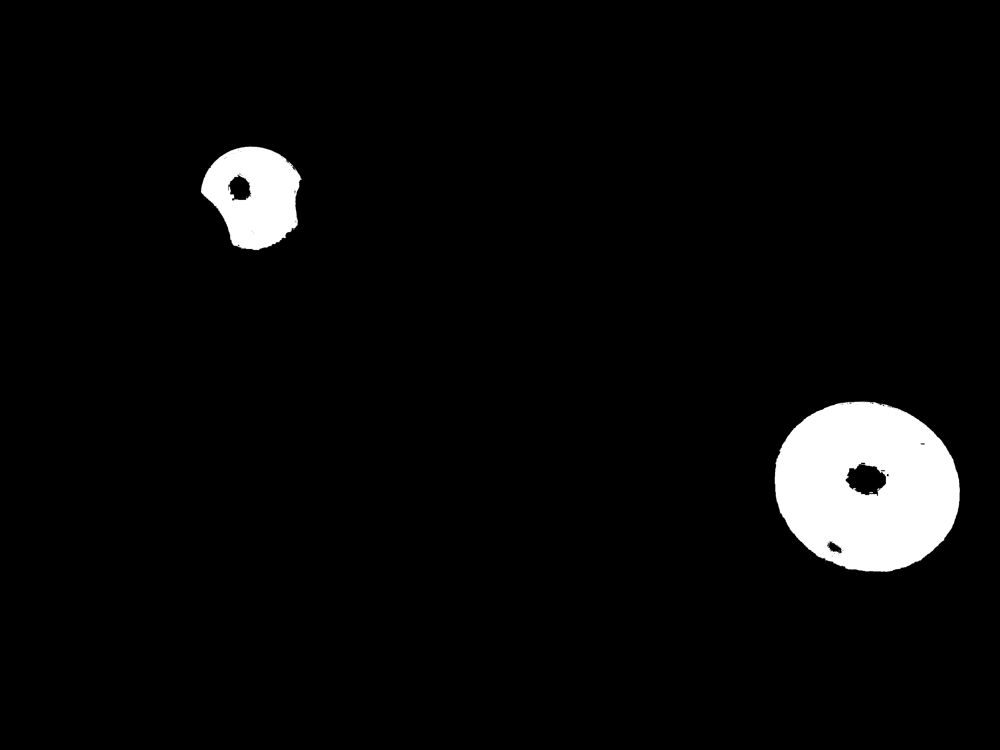

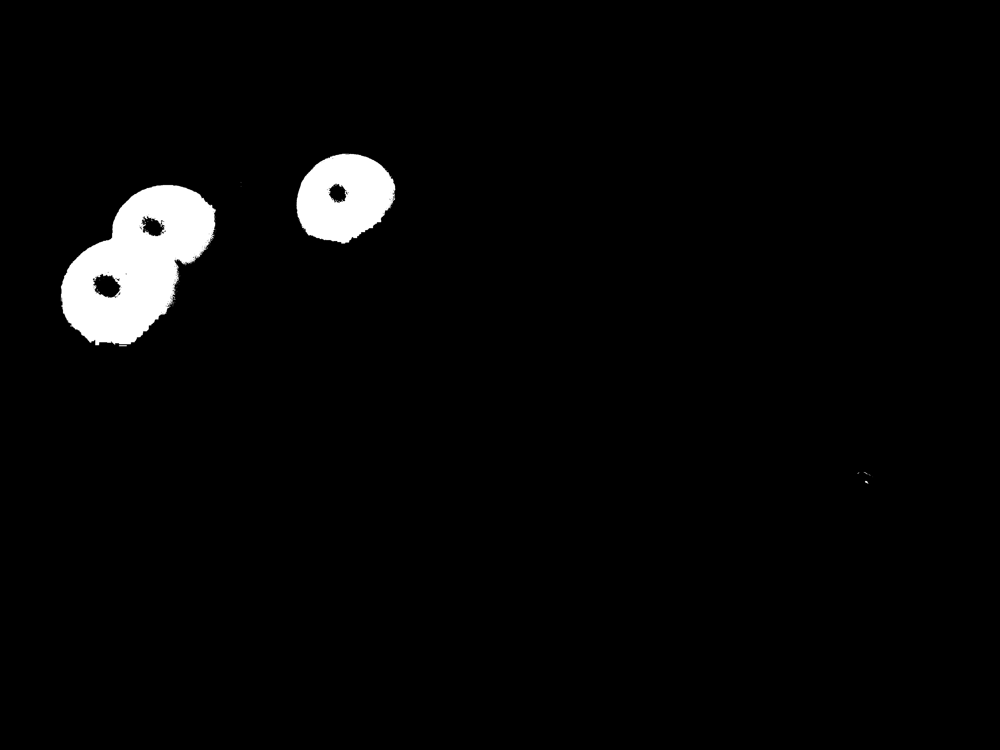

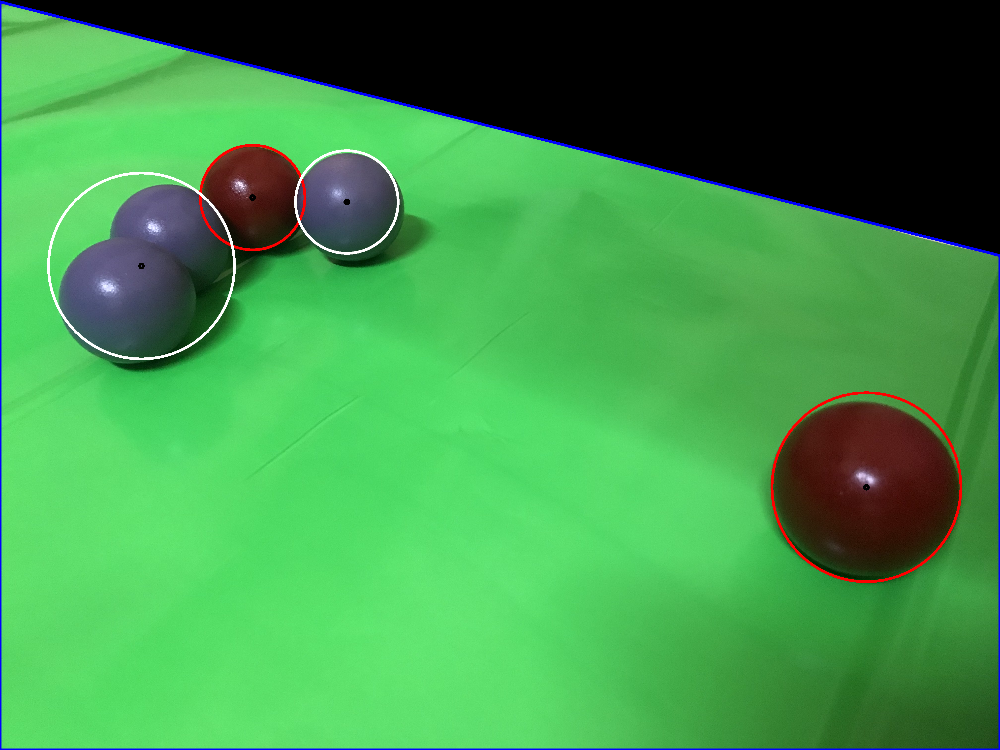

In [104]:
hsv_image = cv2.cvtColor(frame.copy(), cv2.COLOR_BGR2HSV)

centors_red_balls, radiuses_red_ball = detect_balls(hsv_image, color=define_ball_color["red"])
centors_other_balls, radiuses_other_ball = detect_balls(hsv_image, color=define_ball_color["other"], min_radius=10000) 

# Draw the bounding boxes on the image 
frame_debug = frame.copy()

for centor, radius in zip(centors_red_balls, radiuses_red_ball):
    cv2.circle(frame_debug, centor, radius, (0, 0, 255), 10)
    cv2.circle(frame_debug, centor, 8, (0, 0, 0), 10)

for centor, radius in zip(centors_other_balls, radiuses_other_ball):
    cv2.circle(frame_debug, centor, radius, (255, 255, 255), 10)
    cv2.circle(frame_debug, centor, 8, (0, 0, 0), 10)  
bbox = approx 
cv2.drawContours(frame_debug, [bbox], -1, (255, 0, 0), 10)

custom_display(frame_debug)


